In [1]:
import torch 
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision
# import torchvision.transforms as transforms
import torchvision.transforms.functional as TF
import torch.utils.data as data

from PIL import Image
import numpy as np
import shutil

import datetime

import matplotlib.pyplot as plt

import models.segmentation_models as segmentation_models

In [ ]:
from functions.koger_datasets import SegmentationDataset
import koger_augmentors as kaug

# Create Custom Dataset class for segmentation

In [2]:
import glob
import os 
import cv2

class SegmentationDataset(data.Dataset):
    def __init__(self, folder_paths, transform=None, keep_orig=False, max_num_examples=None):
        """
        Args:
            folder_paths (list): list of paths each contains .jpg image files in a folder clled 'images'
                and in folder called 'masks' .png masks
            transform (callable, optional): Optional transforms to be applied on a sample
            keep_orig: keep un-transformed image
            max_num_examples: how many examples to used from folder, if None read all
        """
        self.mask_files = []
        self.img_files = []
        self.keep_orig = keep_orig
        self.num_examples = 0
            
        for folder_path in folder_paths:
            possible_img_files = glob.glob(os.path.join(folder_path, 'images', '*.jpg'))
            if self.num_examples is None:
                self.num_examples += len(possible_img_files)
            for img_num, img_path in enumerate(possible_img_files):
                if not max_num_examples:
                    self._add_annotation(folder_path, img_path)
                else:
                    if self.num_examples < max_num_examples:
                        self._add_annotation(folder_path, img_path)
                    else:
                        break
            
        self.transform = transform
        
    def _add_annotation(self, folder_path, img_path):
            mask_name = os.path.splitext(os.path.basename(img_path))[0]
            self.mask_files.append(os.path.join(folder_path, 'masks', mask_name + '.png'))
            self.img_files.append(img_path)
            self.num_examples += 1
                                   
    def __getitem__(self, index):
            img_path = self.img_files[index]
            mask_path = self.mask_files[index]
            image = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)
            mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            sample = {'image': image[2:-2, 2:-2], 'mask': mask[2:-2, 2:-2]}
            if self.keep_orig:
                sample['orig'] = image
            
            if self.transform:
                sample = self.transform(sample)
            return sample

    def __len__(self):
        return len(self.img_files)

# Create various augmentor classes

In [3]:
import imgaug as ia
import imgaug.augmenters as iaa

class MaskRandomCrop:
    """Rotate by one of the given angles."""

    def __init__(self, crop_size):
        # size of square crop
        self.crop_size = crop_size

    def __call__(self, sample):
        im = sample['image']
        mask = sample['mask']

        im_height = im.shape[0]
        im_width = im.shape[1]
        top = np.random.randint(im_height - self.crop_size)
        left = np.random.randint(im_width - self.crop_size)

        im_crop = im[top:top+self.crop_size, left:left+self.crop_size]
        mask_crop = mask[top:top+self.crop_size, left:left+self.crop_size]
        
        sample['image'] = im_crop
        sample['mask'] = mask_crop

        return sample
    
class MaskImgAug:
    
    def __init__(self):
        # size of square crop
        self.transform = iaa.Sequential([
#             iaa.AdditiveGaussianNoise(scale=(0, 0.1*255)),
            iaa.Sometimes(0.4, iaa.blur.GaussianBlur(sigma=(0.0, 6.0))),
            iaa.Sometimes(0.4, iaa.AdditivePoissonNoise((0, 30)))
        ])

    def __call__(self, sample):
        im = sample['image'].astype(np.uint8)
        im_transform = self.transform(image=np.array(im))
        sample['image'] = im_transform.astype(float)
        
        return sample
    
class Mask2dMultiplyAndAddToBrightness():
    def __init__(self, add, multiply):
        """Add and multiply image values by given amount randomly within range.
        
        Expects image to be between 0 and 255.
        
        Args:
            add: either number of tuple, if tuple randomly choose from range
            multiply: either number ot tuple, if tuple randomly choose from range
        """
        self.add = add
        self.multiply = multiply
        self.rng = np.random.default_rng()
        
    def __call__(self, sample):
        im = sample['image'].astype(np.float64)
        if isinstance(self.add, tuple):
            add_val = self.rng.uniform(self.add[0], self.add[1])
        else:
            add_val = self.add
        if isinstance(self.multiply, tuple):
            multiply_val = self.rng.uniform(self.multiply[0], self.multiply[1])
        else:
            multiply_val = self.multiply
        im += add_val
        im *= multiply_val
        im = np.maximum(im, 0)
        im = np.minimum(im, 255)
        
        sample['image'] = im
        
        return sample
    
    
class MaskToTensor:
    def __call__(self, sample):
        im = sample['image']
        mask = sample['mask']
        
        im_tensor = torch.from_numpy(im).float() / 255
        im_tensor = torch.unsqueeze(im_tensor, 0)
        mask_tensor = torch.from_numpy(np.array(mask, np.int64, copy=False))
        mask_tensor = mask_tensor // 255
        
        sample['image'] = im_tensor
        sample['mask'] = mask_tensor
        
        return sample
    
class Mask3dto2d:
    """ Expects images of size NxMxC"""
    def __init__(self, channel_to_use):
        self.channel_to_use = channel_to_use
    
    def __call__(self, sample):
        im = sample['image']
        sample['image'] = im[..., self.channel_to_use]
       
        return sample
    
class MaskCompose:
    def __init__(self, transform_list):
        """Chain together transforms in transform.
         Expect transform on both image and mask in dict
         
         Args:
             transform_list (list): list of custom augmentations
         """
        self.transform_list = transform_list
    
    def __call__(self, sample):
        for transform in self.transform_list:
            sample  = transform(sample)
        return sample
    
class MaskNormalize:
    def __init__(self, mean, std):
        """Normalize image, leave mask unchanged"""
        self.mean = mean
        self.std = std
        
    def __call__(self, sample):
        im = sample['image']
        im_norm = TF.normalize(im, self.mean, self.std)
        
        sample['image'] = im_norm
        return sample
    
class MaskContrast:
    def __init__(self, contrast_factor):
        """Change image contrast, leave mask unchanged
        
        Args:
            contrast_factor: single value or tuple"""
        self.contrast_factor = contrast_factor
        self.rng = np.random.default_rng()

    def __call__(self, sample):
        im = sample['image']
        if isinstance(self.contrast_factor, tuple):
            contrast_factor = self.rng.uniform(self.contrast_factor[0], self.contrast_factor[1])
        else:
            contrast_factor = self.contrast_factor
        im_height, im_width = im.shape
        aprox_mean = np.mean([im[0,0], im[-1, 0], im[0, -1], im[-1, -1], 
                              im[im_height//2, im_width//2], im[-im_height//2, -im_width//2]])
        im_contrast = aprox_mean + contrast_factor * (im - aprox_mean)
        im_contrast = np.maximum(im_contrast, 0)
        im_contrast = np.minimum(im_contrast, 255)
        sample['image'] = im_contrast
        return sample
    
class MaskCenterImage:
    def __init__(self):
        pass
    def __call__(self, sample):
        im = sample['image']
        mean = np.mean(im[::10, ::10])
        bias = 125 - int(mean)
        bias = np.max([0, bias])
        sample['image'] += bias
        sample['image'] = np.where(sample['image'] > 255, 255, sample['image'])
        return sample

In [4]:
def get_conf_matrix(conf_matrix, num_classes, pred_batch, mask_batch):
    """ Calculate confusion matrix and add to passed confusion matrix.
    
    Args:
        conf_matrix (np array): confusion matrix size 
            (num_classes + 1, num_classes + 1)
        num_classes (int): number of classes being segmented
        pred_batch (np array): NxM or BxNxM
        mask_batch (np array): NxM or BxNxM
    """
    
    N = num_classes + 1

    if len(pred_batch.shape) == 2:
        pred_batch = np.expand_dims(pred_batch, 0)
        mask_batch = np.expand_dims(mask_batch, 0)
    for pred, mask in zip(pred_batch, mask_batch):
        conf_matrix += np.bincount(
            N * pred.reshape(-1) + mask.reshape(-1), minlength=N ** 2
        ).reshape(N, N)
    return conf_matrix

def evaluate(num_classes, conf_matrix):
    """ Caclculate Accuracy and IOU scores.
    
    Args:
        num_classes (int): num classes
        conf_matrix (np array): confusion matrix of size 
            (num_classes + 1, num_classes + 1)
    """
    acc = np.full(num_classes, np.nan, dtype=np.float)
    iou = np.full(num_classes, np.nan, dtype=np.float)
    tp = conf_matrix.diagonal()[:-1].astype(np.float)
    pos_gt = np.sum(conf_matrix[:-1, :-1], axis=0).astype(np.float)
    class_weights = pos_gt / np.sum(pos_gt)
    pos_pred = np.sum(conf_matrix[:-1, :-1], axis=1).astype(np.float)
    acc_valid = pos_gt > 0
    acc[acc_valid] = tp[acc_valid] / pos_gt[acc_valid]
    iou_valid = (pos_gt + pos_pred) > 0
    union = pos_gt + pos_pred - tp
    iou[acc_valid] = tp[acc_valid] / union[acc_valid]
    macc = np.sum(acc[acc_valid]) / np.sum(acc_valid)
    miou = np.sum(iou[acc_valid]) / np.sum(iou_valid)
    fiou = np.sum(iou[acc_valid] * class_weights[acc_valid])
    pacc = np.sum(tp) / np.sum(pos_gt)
    
    return iou, acc

import time

def train(model, num_classes, train_dl, val_dl, loss_fn, optimizer, 
          acc_fn, epochs=1, lr_scheduler=None, save_best_val=False,
          model_file='model.tar', accumulation_steps=1, val_epoch=1, 
          show_images=False):
    start = time.time()
    
    train_loss, valid_loss = [], []
    
    # calc max usuable batchnum
    max_batchnum = ((len(train_dl) // accumulation_steps) 
                    * accumulation_steps)
    print("using {} batches ({} images)".format(
        max_batchnum, max_batchnum * train_dl.batch_size))
    
    model.cuda()
    
    top_val_loss = 100000000000

    for epoch in range(epochs):
        
        if epoch % 1 == 0:
            print('Epoch {}/{}'.format(epoch, epochs - 1))
        
        optimizer.zero_grad()
        
        for phase in ['train', 'val']:
            phase_start = time.time()
            if phase == 'train':
                model.train(True)
                dataloader = train_dl
            else:
                if epoch % val_epoch != 0:
                    continue
                model.train(False)
                dataloader = val_dl
                conf_matrix = np.zeros((num_classes+1, num_classes+1), dtype=np.int64)
                
            running_loss = 0.0
            running_acc = 0.0
            
            step = 0
            
            
            
            # iterate over data
            for batch_ind, batch in enumerate(dataloader):
                if batch_ind >= max_batchnum:
                    break
                im_batch = batch['image'].cuda()
                masks = batch['mask'][:, 46:-46, 46:-46].cuda()
#                 print(batch['image'].size(), batch['mask'][46:-46, 46:-46].shape)
                
                if phase == 'train':
                    outputs = model(im_batch)
                    loss = loss_fn(outputs, masks)
                    loss.backward()
                    if (batch_ind+1) % accumulation_steps == 0:
                        # Wait for several backward steps
                        # Now we can do an optimizer step
                        optimizer.step()
                        if lr_scheduler:
                            lr_scheduler.step()
                        model.zero_grad() 
                else:
                    with torch.no_grad():
                        outputs = model(im_batch)
                        loss = loss_fn(outputs, masks)
                        np_outputs = outputs.cpu().numpy()
                        np_preds = np.argmax(np_outputs, axis=1)
                        np_masks = masks.cpu().numpy()
                        conf_matrix = get_conf_matrix(conf_matrix, num_classes, 
                                                      np_preds, np_masks)
                        
                if show_images:
                    np_im_batch = batch['image'].numpy()
                    for im in np_im_batch:
                        plt.figure()
                        plt.imshow(np.squeeze(im))
                        plt.title(phase)

                running_loss += loss.item()*dataloader.batch_size
                
                
                step += 1
                
            epoch_loss = running_loss / len(dataloader.dataset)
            if epoch % 1 == 0:
                
                phase_length = time.time() - phase_start
                fps =  (len(dataloader) * len(batch)) / phase_length
                
                print('{} Loss: {:.4f}  AllocMem (Mb): {:.3f} MaxMem(Mb) {:.3f}Time: {:.3f} fps: {:.3f}'.format(
                    phase, epoch_loss, torch.cuda.memory_allocated()/1024/1024, 
                    torch.cuda.max_memory_allocated()/1024/1024, phase_length, fps))
            if phase == 'val':
                valid_loss.append(epoch_loss)
                if epoch_loss < top_val_loss:
                    top_val_loss = epoch_loss
                    if save_best_val:
                        torch.save(model.state_dict(), model_file)
                        print('saved new model. val loss {}'.format(epoch_loss))
                    
                iou, acc = evaluate(num_classes, conf_matrix)
                print('IOU: {}, Acc: {}'.format(iou, acc))
            else:
                train_loss.append(epoch_loss) 

        time_elapsed = time.time() - start   

    return train_loss, valid_loss 
    
def acc_metric(predb, yb):
    return (predb.argmax(dim=1) == yb.cuda()).float().mean()

# Live code

In [5]:
annotation_folders = [
                      "/home/golden/Dropbox/for-hemal-vtk/demo_datasets/bat_segmentation_2",
                      "/home/golden/Dropbox/for-hemal-vtk/demo_datasets/bat_segmentation_1"
                     ]

In [6]:
train_folders = [os.path.join(folder, 'train') for folder in annotation_folders]
val_folders = [os.path.join(folder, 'val') for folder in annotation_folders]
mean = np.load(os.path.join(annotation_folders[0], 'mean.npy'))
std = np.load(os.path.join(annotation_folders[0], 'std.npy'))

In [7]:
files = sorted(glob.glob("/home/golden/Dropbox/for-hemal-vtk/demo_datasets/bat_segmentation_1/val/images/*"))
# for file in files[:]:
#     print(plt.imread(file)[...,2].shape)
#     break
    

## Build data transforms (preprossessing)

In [8]:
channel = 2

train_data_transforms = torchvision.transforms.Compose([Mask3dto2d(channel),
                                                        MaskRandomCrop(1028),
                                                        Mask2dMultiplyAndAddToBrightness(
                                                                multiply=(0.1, 1.2), add=(-50, 0)),
                                                        MaskContrast(contrast_factor=(0.3, 1.3)),
                                                        MaskImgAug(),
#                                                         MaskCenterImage(),
                                                        MaskToTensor(), 
                                                        MaskNormalize(mean[channel], std[channel])
                                                       ]
                                                      )

# Doesn't normalize so images still in scale good for plt.imshow
visualize_data_transforms = torchvision.transforms.Compose([Mask3dto2d(channel),
                                                            MaskRandomCrop(1028),
                                                            Mask2dMultiplyAndAddToBrightness(
                                                                multiply=(0.5, 1.2), add=(-50, 0)),
                                                            MaskContrast(contrast_factor=(0.6, 1.3)),
                                                            MaskImgAug(),
#                                                             MaskCenterImage(),
                                                            MaskToTensor(),
                                                           ]
                                                          )
val_data_transforms = torchvision.transforms.Compose([Mask3dto2d(channel),
#                                                       MaskRandomCrop(1028), 
#                                                       Mask2dMultiplyAndAddToBrightness(
#                                                                 multiply=(0.5, 1.2), add=(-50, 0)),
#                                                       MaskContrast(contrast_factor=(0.6, 1.3)),
# #                                                       MaskCenterImage(),
#                                                       MaskImgAug(),
                                                      MaskToTensor(), 
                                                      MaskNormalize(mean[channel], std[channel])
                                                     ]
                                                    )

## Build DataLoaders

In [9]:
# This is important for data augementation to work properly
# with parrallel data loading. By default when each process
# is created in parrallel seed will be intitialized to same value
# so augmentation won't be random across images in batch
# (specifically for numpy based preprosseseing)
def worker_init_fn(worker_id):
    np.random.seed(datetime.datetime.now().microsecond + worker_id * 1000000)


batch_size = 4

train_dataset = SegmentationDataset(train_folders, train_data_transforms)
train_dataloader = data.DataLoader(train_dataset, batch_size=batch_size,
                                   shuffle=True, num_workers=7, pin_memory=True,
                                   worker_init_fn=worker_init_fn)
# To confirm data is as expected
visualize_dataset = SegmentationDataset(train_folders, visualize_data_transforms)

val_dataset = SegmentationDataset(val_folders, val_data_transforms)
val_dataloader = data.DataLoader(val_dataset, batch_size=batch_size,
                                 shuffle=True, num_workers=7, pin_memory=True,
                                 worker_init_fn=worker_init_fn)

test_folder = "/home/golden/kenya_drones/kasanka-bats/annotations"
test_folder = "/home/golden/Dropbox/bats-code/data/test"
test_dataset = SegmentationDataset([test_folder], val_data_transforms)
test_dataloader = data.DataLoader(test_dataset, batch_size=batch_size,
                                   shuffle=True, num_workers=7, pin_memory=True,
                                   worker_init_fn=worker_init_fn)

In [10]:
test_dataset[0]['image'].size()

torch.Size([1, 1516, 2700])

## Visualize Dataset

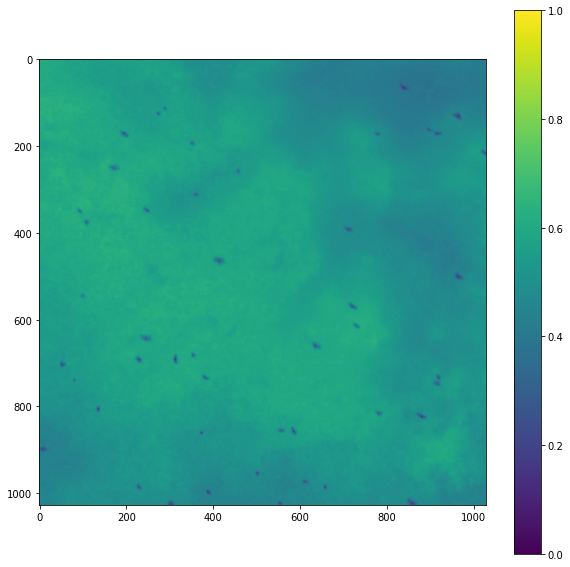

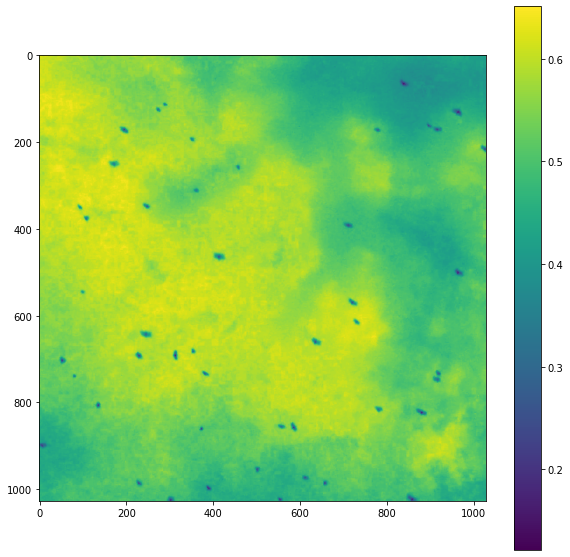

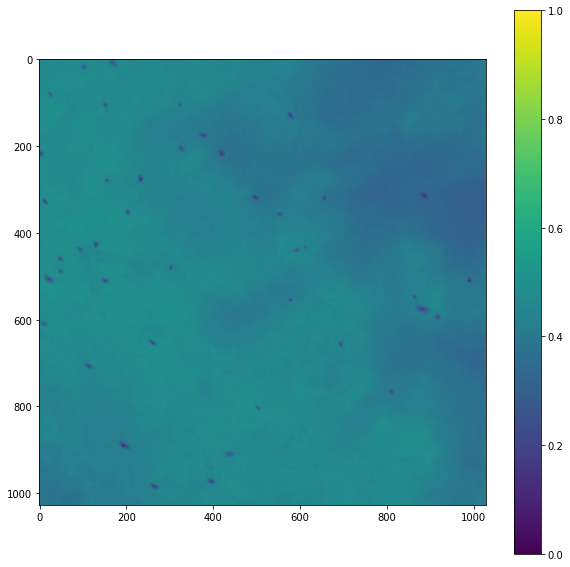

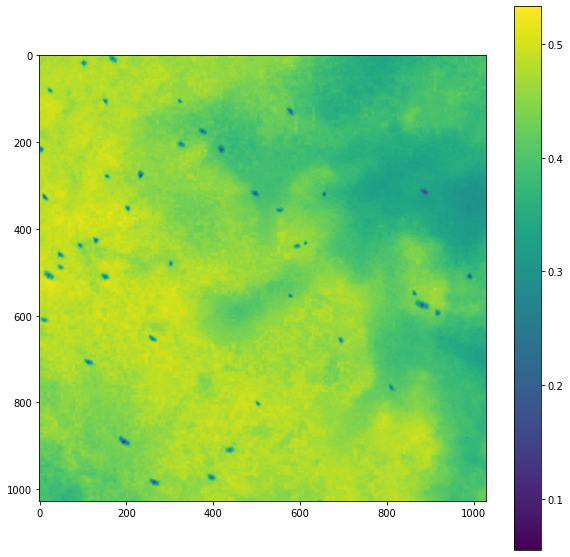

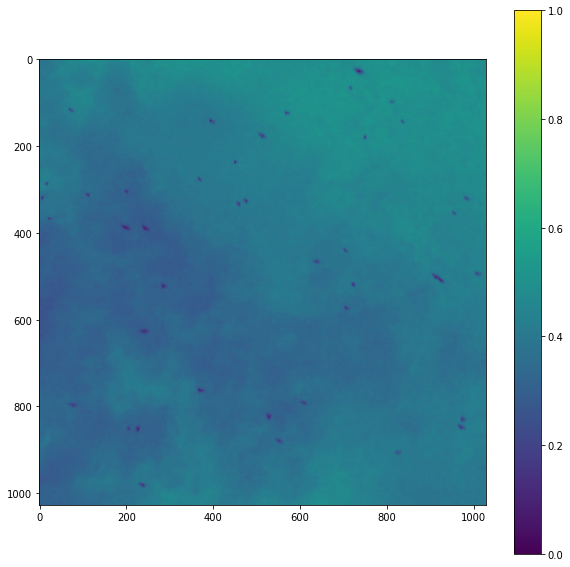

...

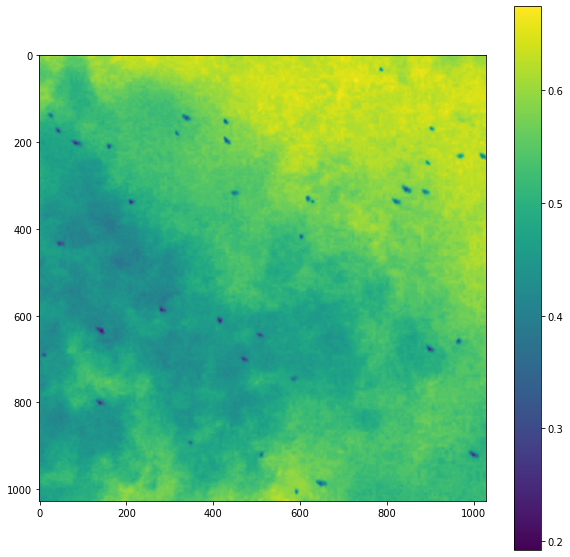

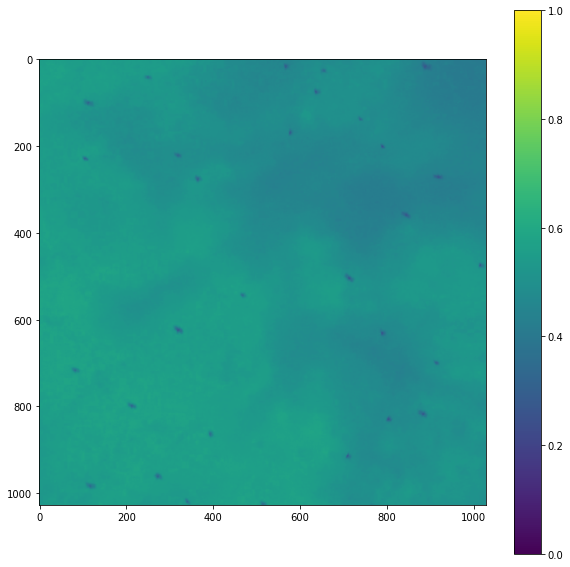

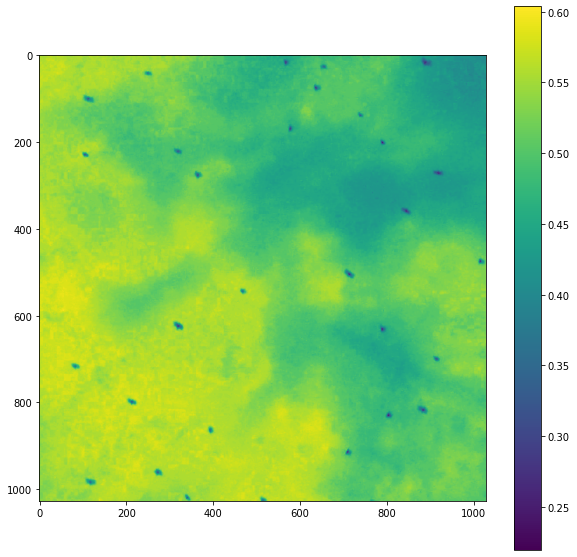

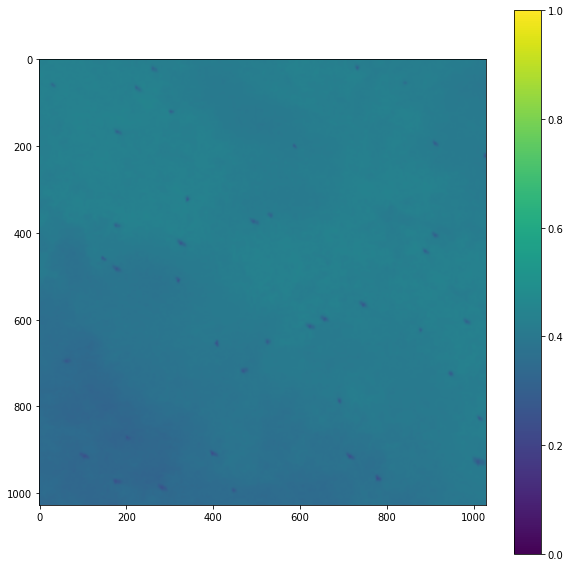

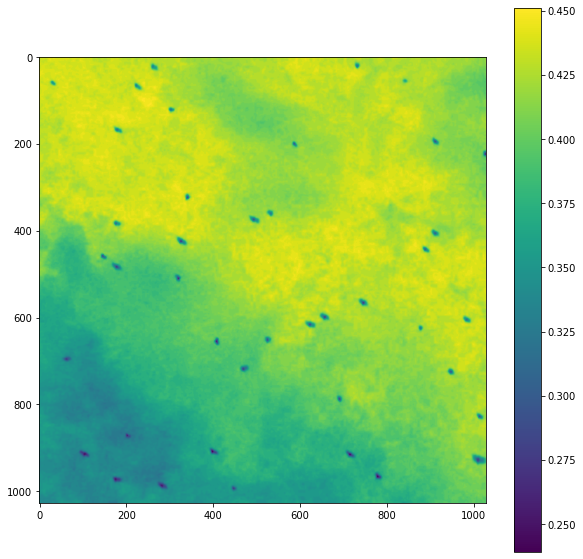

In [11]:
visualize = True
if visualize:
    for ind in range(8):
        sample = visualize_dataset[ind]
        im = sample['image'].numpy()
        mask = sample['mask'].numpy()
        im = np.squeeze(im)
        if len(im.shape) == 3:
            im = np.transpose(im, (1, 2, 0))
        plt.figure(figsize=(10,10))
        plt.imshow(im, vmin=0, vmax=1.0)
        plt.colorbar()
        plt.figure(figsize=(10,10))
        plt.imshow(im)
        plt.colorbar()

# Train Model

In [12]:
def get_foreground_background_ratio(dataloader):
    """ See how imbalanced dataset is between forground and background.
    
    Expects mask to be included with each data item.
    
    Args:
        dataloader: torch Dataloader object for dataset"""
    total_background = 0
    total_foreground = 0
    for batch in dataloader:
        for mask in batch['mask'].numpy():
            foreground = np.sum(mask)
            total = mask.shape[0] * mask.shape[1]
            background = total - foreground
            total_background += background
            total_foreground += foreground
    all_pixels = total_foreground + total_background 
    return total_foreground/all_pixels, total_background/all_pixels

In [13]:
# This can be helpful for thinking about weight values in NLLLoss
foreground, background = get_foreground_background_ratio(train_dataloader)
print('The training set is {} foreground pixels'.format(foreground))

The training set is 0.0029239466153916033 foreground pixels


In [14]:

loss_fn = torch.nn.NLLLoss(weight=torch.tensor([.01, .99]).cuda())
# loss_fn = torch.nn.NLLLoss(weight=torch.tensor([1.0, 1.0]).cuda())

lr = .05
# Number of batches to run before updating weights
# Effectively increasing batch size from a stability
# point of view even if memory is limited
accumulation_steps = 4 
epochs = 100
momentum = 0.9
conv1_outdim = 8
conv2_outdim = 32
dialation = 16

aug_type = "noise-centered-dark"

folder = './trained_models'
os.makedirs(folder, exist_ok=True)

model_type = 'UNET'

if model_type == 'UNET':
    model = segmentation_models.UNET(1, 2, should_pad=False)
    model_name = 'model_{}_epochs_{}_batcheff_{}_lr_{}_momentum_{}_aug_{}'.format(
    model.name, epochs, accumulation_steps*batch_size, lr, momentum, aug_type)
else:
    model_name = 'model_{}_conv1_outdim_{}_conv2_outdim_{}_dialation_{}_epochs_{}_batcheff_{}_lr_{}_momentum_{}_aug_{}'.format(
        model.name, conv1_outdim, conv2_outdim, dialation, epochs, accumulation_steps*batch_size, lr, momentum, aug_type)
    model = segmentation_models.ThreeLayerSemSegNetHighDim(
        1, 2, conv1_outdim=conv1_outdim, conv2_outdim=conv2_outdim,
        dialation=dialation
    )
print('Using model {}'.format(model.name))
model_file = os.path.join(folder, model_name + '.tar')

Using model UNET


In [15]:
def lr_scheduler(epoch):
    """ To pass to torch optim lr_scheduler.
    
    Args:
        epoch: current epoch number
        
    return number to multiply base lr
    """
    
    if epoch < 50:
        return 1.0
    elif epoch < 250:
        return 0.2
    else:
        return 0.05


optimizer = torch.optim.SGD(model.parameters(), lr=lr, momentum=momentum)
scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer, lr_scheduler, last_epoch=-1)

In [ ]:
save_model = True
train_loss, val_loss = train(model, 2, train_dataloader, val_dataloader,
                            loss_fn, optimizer, acc_metric, epochs=epochs, 
                             accumulation_steps=accumulation_steps, val_epoch=1,
                             lr_scheduler=scheduler, save_best_val=True,
                             model_file=model_file, show_images=False)

# if save_model:
#     torch.save(model.state_dict(), model_file)
    
plt.plot(train_loss, label='Train')
plt.plot(val_loss, label='Val')
plt.legend()

np.save(os.path.join('./model_losses', 'val-loss_' + model_name), val_loss)
np.save(os.path.join('./model_losses', 'train-loss_' + model_name), train_loss)

using 24 batches (96 images)
Epoch 0/99
train Loss: 0.5443  AllocMem (Mb): 75.768 MaxMem(Mb) 7057.601Time: 17.020 fps: 2.938
val Loss: 0.5421  AllocMem (Mb): 295.422 MaxMem(Mb) 7057.601Time: 5.769 fps: 1.733
saved new model. val loss 0.5421322286128998
IOU: [0.99696114 0.        ], Acc: [1. 0.]
Epoch 1/99
train Loss: 0.4997  AllocMem (Mb): 75.768 MaxMem(Mb) 7057.601Time: 17.073 fps: 2.929
val Loss: 30.9100  AllocMem (Mb): 295.963 MaxMem(Mb) 7057.601Time: 5.319 fps: 1.880
IOU: [0.99696114 0.        ], Acc: [1. 0.]
Epoch 2/99
train Loss: 0.4785  AllocMem (Mb): 75.768 MaxMem(Mb) 7057.601Time: 17.208 fps: 2.906
val Loss: 0.5339  AllocMem (Mb): 295.963 MaxMem(Mb) 7057.601Time: 5.521 fps: 1.811
saved new model. val loss 0.5339089214801789
IOU: [0.99696114 0.        ], Acc: [1. 0.]
Epoch 3/99
train Loss: 0.4549  AllocMem (Mb): 75.768 MaxMem(Mb) 7057.601Time: 17.324 fps: 2.886
val Loss: 0.5964  AllocMem (Mb): 295.963 MaxMem(Mb) 7057.601Time: 5.516 fps: 1.813
IOU: [0.99696114 0.        ], Acc: 

In [ ]:
plt.plot(train_loss, label='Train')
plt.plot(val_loss, label='Val')
plt.legend()
np.save('train_sgd_momentum_0_9.npy', train_loss)
np.save('val_sgd_momentum_0_9.npy', val_loss)

# Evaluate

In [14]:
def acc_metric_cpu(predb, yb):
    """Accuracy metric set to run on CPU"""
    return (np.mean(np.argmax(predb, axis=1) == yb).astype(float))

def logit2prob(logit):
    """ Converts logit to probabilitu"""
    e_l = np.e ** logit
    return e_l 

def rescale(im):
    """ Rescale array to be strictly from 0 to 255"""
    im = im
    im -= im.min()
    im /= im.max()
    im *= 255
    return im.astype(int)

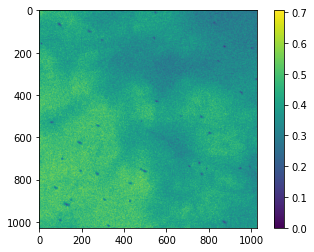

In [15]:
plt.imshow(im)
plt.colorbar()

/home/golden/torchvision-venv/lib/python3.6/site-packages/ipykernel_launcher.py:74: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


num_images: 8
(array([0.99495037, 0.30716894]), array([0.99564091, 0.76347698]))
epoch loss 0.02017252817749977


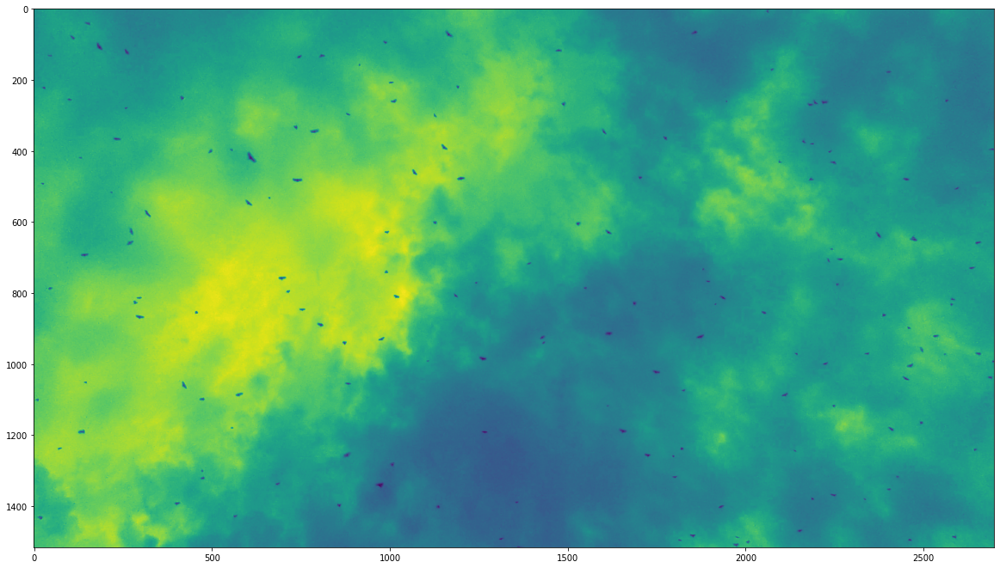

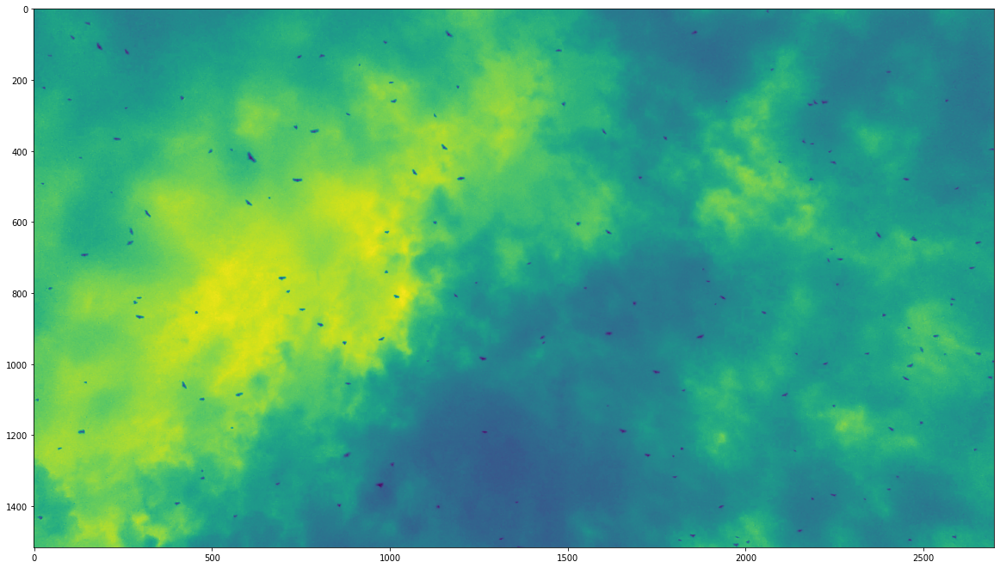

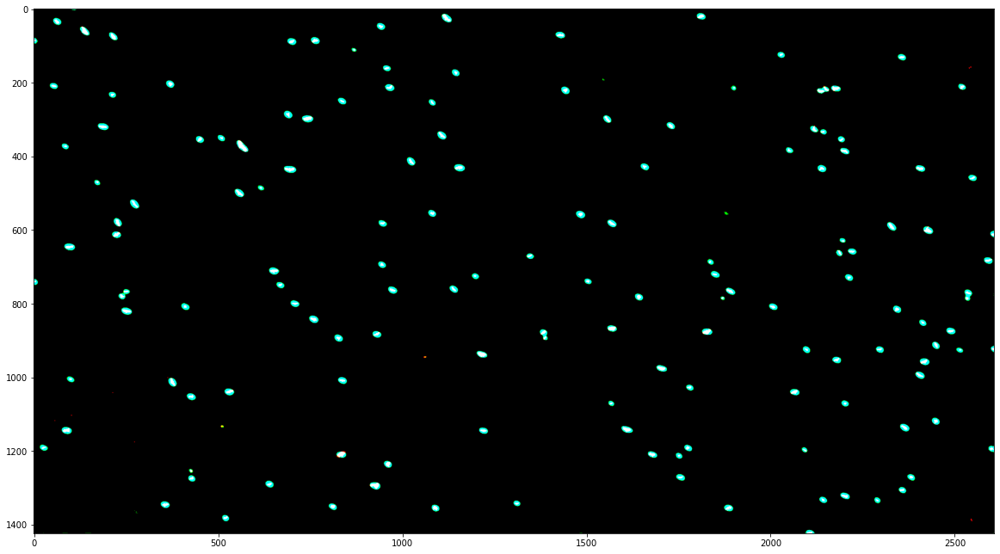

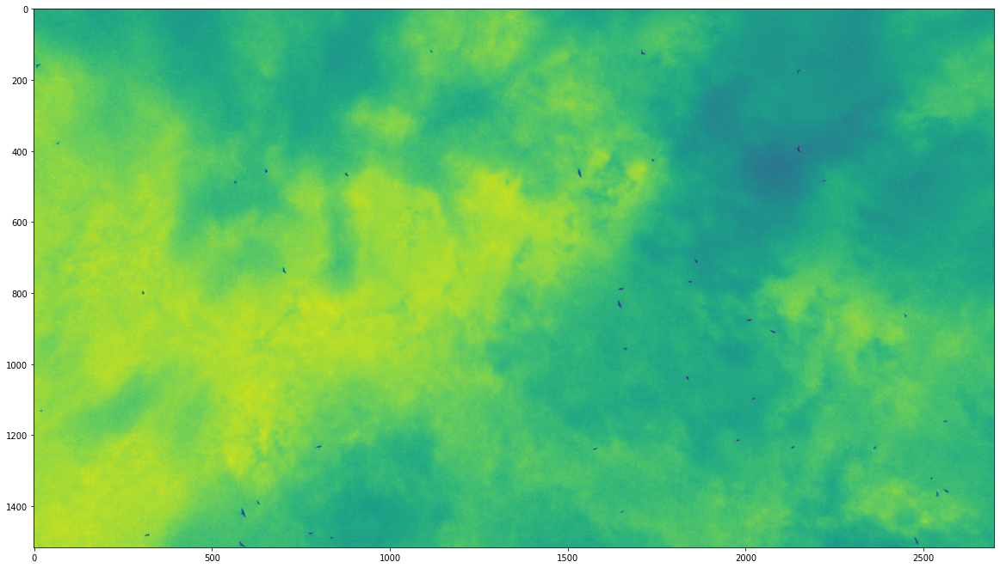

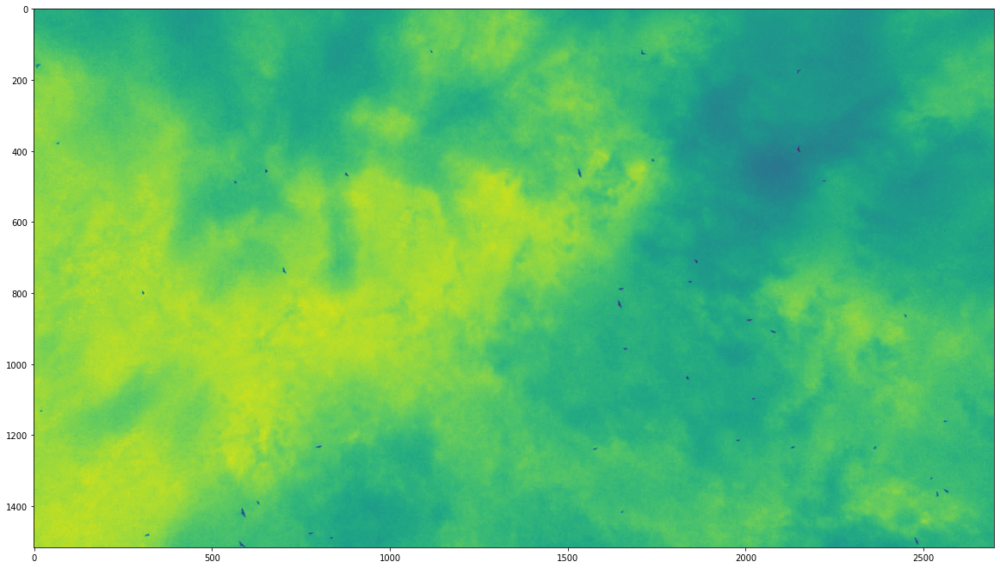

...

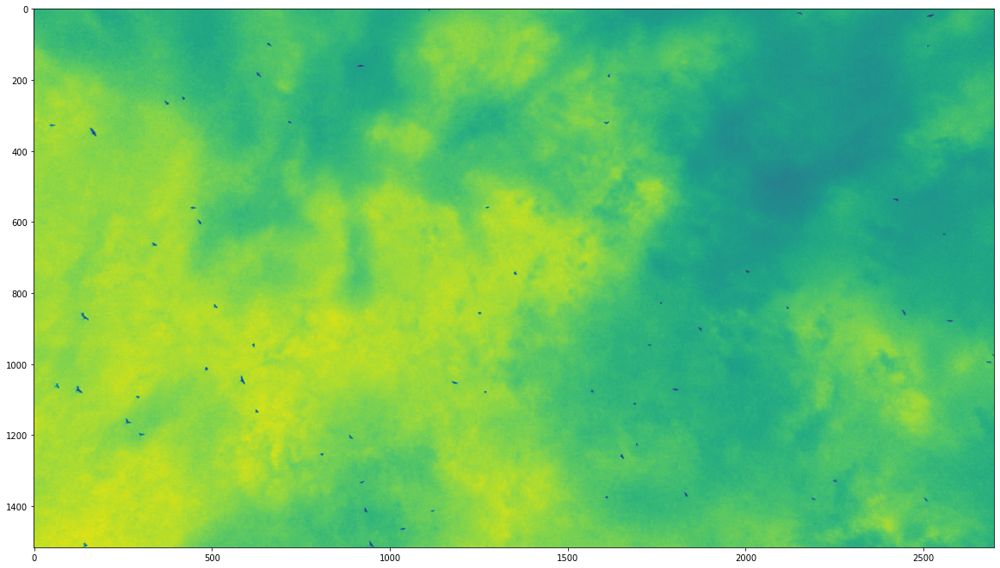

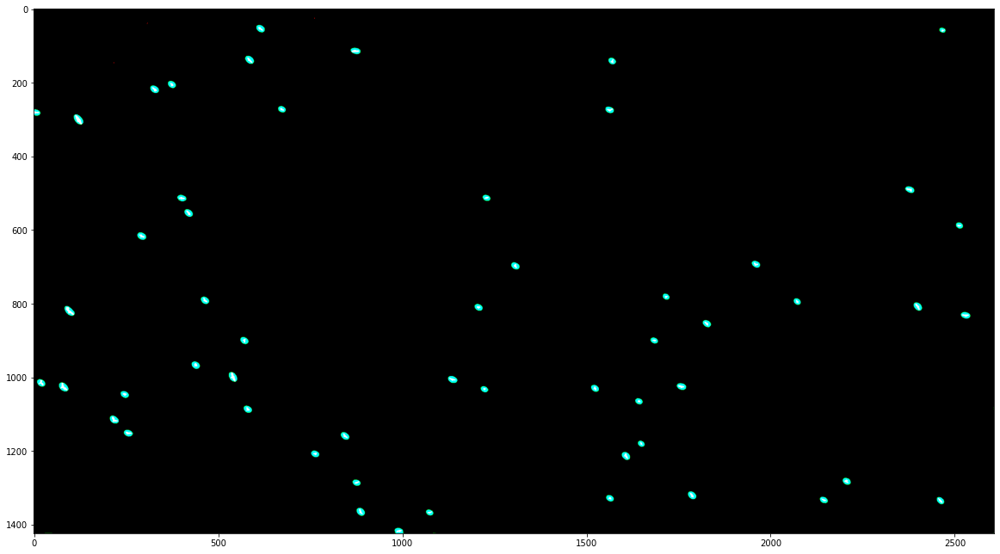

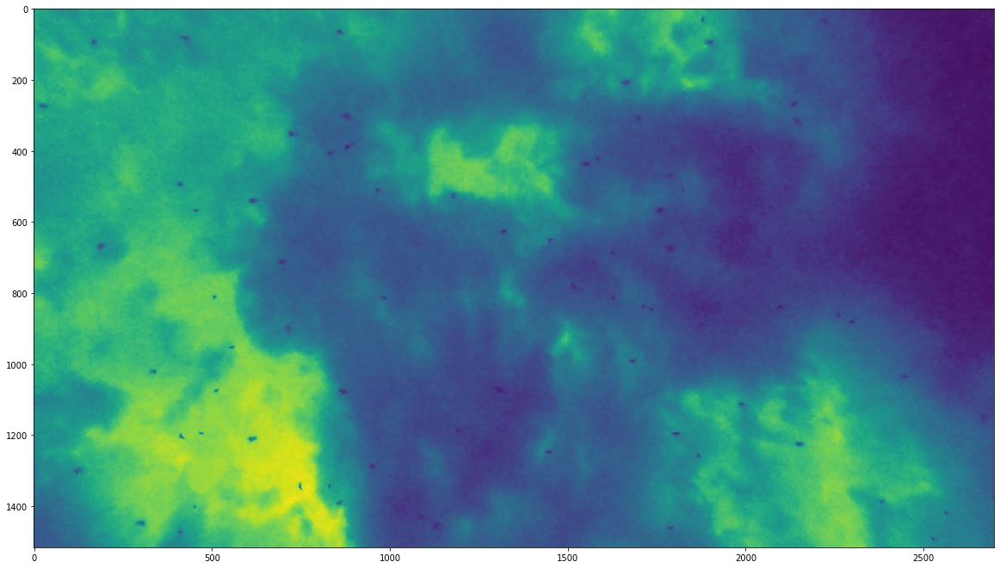

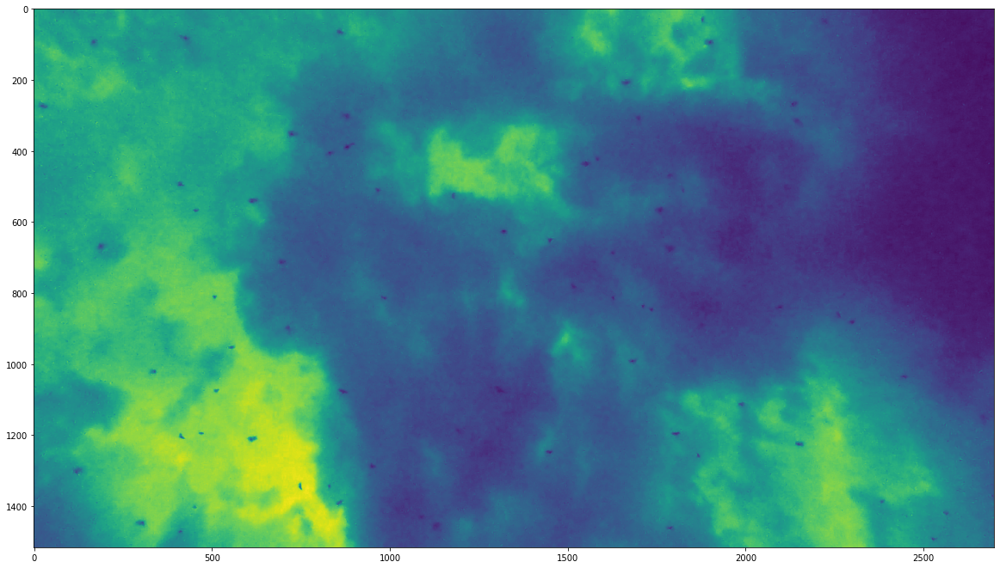

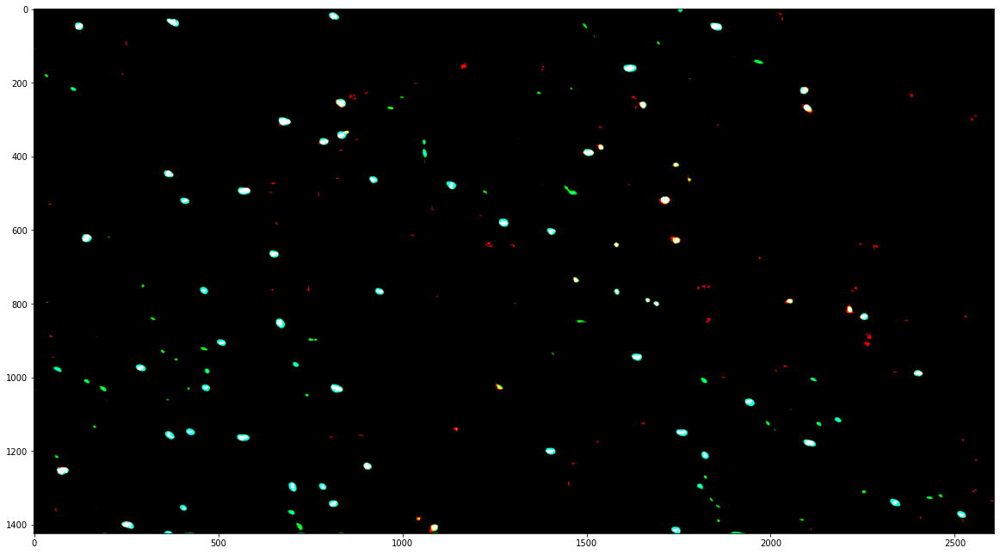

In [16]:
should_plot = True

# Data loader for images that are used to evaluate model
dataloader = test_dataloader

device = torch.device("cuda")
# model =  segmentation_models.ThreeLayerSemSegNetHighDim(1, 2, conv1_outdim=conv1_outdim,
#                                                        conv2_outdim=conv2_outdim,
#                                                        dialation=dialation)
model =  segmentation_models.UNET(1, 2, should_pad=False)
model.load_state_dict(torch.load(model_file))
model.to(device)
model.train(False)

loss_fn = torch.nn.NLLLoss(weight=torch.tensor([.08, .92]).cuda())

# How many batches to run (might want small for plotting)
# Only used when should_plot is True
num_batches = 2 

num_classes = 2
conf_matrix = np.zeros((num_classes+1, num_classes+1), dtype=np.int64)


num_frames = 0
running_loss = 0
padded_edge = 46

for batch_ind, batch in enumerate(dataloader):
    
    
    if batch_ind >= num_batches and should_plot:   
        break
        
    im_batch = batch['image'].cuda()
    masks = batch['mask'][:, padded_edge:-padded_edge, padded_edge:-padded_edge].cuda()
    
    with torch.no_grad():
        outputs = model(im_batch)
        num_frames += len(im_batch)
    loss = loss_fn(outputs, masks)
    running_loss += loss.item()*dataloader.batch_size
    
    outputs = outputs.cpu().numpy()
    preds = np.argmax(outputs, axis=1)
    masks = batch['mask'][:, padded_edge:-padded_edge, padded_edge:-padded_edge].numpy()
    
    conf_matrix = get_conf_matrix(conf_matrix, num_classes, 
                                  preds, masks)
    
    if should_plot:
        for ind in range(len(im_batch)):
            if 'orig' in batch.keys():
                plt.figure(figsize=(10,10))
                plt.imshow(batch['orig'][ind])
            plt.figure(figsize=(20,20))
            im = im_batch[ind].cpu().numpy()
            im = np.transpose(im, (1, 2, 0))
            plt.imshow(rescale(np.copy(im)), vmin=0, vmax=255)
            plt.figure(figsize=(20,20))
            plt.imshow(im)
#             plt.figure(figsize=(20,20))
#             plt.imshow(im)
            
            display_im = np.zeros((masks[ind].shape[0], masks[ind].shape[1], 3))
            display_im[..., 0] = masks[ind]
            prob_bat = logit2prob(outputs[ind,1])
#             display_im[..., 1] = logit2prob(outputs[ind,1])
            display_im[..., 2] = np.where(prob_bat>.8, 1, 0)
            display_im[..., 1] = np.argmax(outputs[ind], axis=0)

            
#             plt.colorbar()
            plt.figure(figsize=(20,20))
            plt.imshow(display_im)
                                        
                                            
#             plt.imshow(masks[ind])
#             plt.figure(figsize=(10,10))
#             plt.imshow(logit2prob(outputs[ind,1]))
#             plt.colorbar()
    
        
    
print('num_images:', num_frames)    
    
print(evaluate(num_classes, conf_matrix))
print('epoch loss {}'.format(running_loss / len(dataloader.dataset)))

In [44]:
class UNET(nn.Module):
    def __init__(self, in_channels, out_channels, should_pad=True):
        super().__init__()
        self.name = 'UNET'
        if should_pad:
            conv1_pad = 3
            gen_pad = 1
        else:
            conv1_pad = 0
            gen_pad = 0
        self.conv1 = self.contract_block(in_channels, 32, 7, conv1_pad)
        self.conv2 = self.contract_block(32, 64, 3, gen_pad)
        self.conv3 = self.contract_block(64, 128, 3, gen_pad)

        self.upconv3 = self.expand_block(128, 64, 3, gen_pad)
        self.upconv2 = self.expand_block(64*2, 32, 3, gen_pad)
        self.upconv1 = self.expand_block(32*2, out_channels, 3, gen_pad)
        
        self.softmax = torch.nn.LogSoftmax(dim=1)

    def __call__(self, x):

        # downsampling part
        print(x.size())
        conv1 = self.conv1(x)
        print('conv1', conv1.size())
        conv2 = self.conv2(conv1)
        print('conv2', conv2.size())
        conv3 = self.conv3(conv2)
        print('conv3', conv3.size())

        upconv3 = self.upconv3(conv3)
        print('upconv3', upconv3.size())
        cat1_trim = 6
        cat2_trim = 18
        print('conv2_slice', conv2[:, :, cat1_trim:-cat1_trim, cat1_trim:-cat1_trim].size())
        upconv2 = self.upconv2(torch.cat([upconv3, conv2[:, :, cat1_trim:-cat1_trim, cat1_trim:-cat1_trim]], 1))
        upconv1 = self.upconv1(torch.cat([upconv2, conv1[:, :, cat2_trim:-cat2_trim, cat2_trim:-cat2_trim]], 1))
        xout = self.softmax(upconv1)

        return xout

    def contract_block(self, in_channels, out_channels, kernel_size, padding):

        contract = nn.Sequential(
            torch.nn.Conv2d(in_channels, out_channels, kernel_size=kernel_size, stride=1, padding=padding),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.ReLU(),
            torch.nn.Conv2d(out_channels, out_channels, kernel_size=kernel_size, stride=1, padding=padding),
            torch.nn.BatchNorm2d(out_channels),
            torch.nn.ReLU(),
            torch.nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
                                 )

        return contract

    def expand_block(self, in_channels, out_channels, kernel_size, padding):

        expand = nn.Sequential(torch.nn.Conv2d(in_channels, out_channels, kernel_size, stride=1, padding=padding),
                            torch.nn.BatchNorm2d(out_channels),
                            torch.nn.ReLU(),
                            torch.nn.Conv2d(out_channels, out_channels, kernel_size, stride=1, padding=padding),
                            torch.nn.BatchNorm2d(out_channels),
                            torch.nn.ReLU(),
                            torch.nn.ConvTranspose2d(out_channels, out_channels, kernel_size=3, stride=2, padding=1, output_padding=1) 
                            )
        return expand

In [45]:
model = UNET(1, 2, should_pad=False)
_ = model.train(False)

In [46]:
for i in train_dataloader:
    model(i['image'])
    break

torch.Size([4, 1, 1028, 1028])
conv1 torch.Size([4, 32, 508, 508])
conv2 torch.Size([4, 64, 252, 252])
conv3 torch.Size([4, 128, 124, 124])
upconv3 torch.Size([4, 64, 240, 240])
conv2_slice torch.Size([4, 64, 240, 240])


In [47]:
image = np.expand_dims(test_dataset[0]['image'], 0)
out = model(torch.from_numpy(image))

torch.Size([1, 1, 1520, 2700])
conv1 torch.Size([1, 32, 754, 1344])
conv2 torch.Size([1, 64, 375, 670])
conv3 torch.Size([1, 128, 186, 333])
upconv3 torch.Size([1, 64, 364, 658])
conv2_slice torch.Size([1, 64, 363, 658])


RuntimeError: Sizes of tensors must match except in dimension 1. Got 364 and 363 in dimension 2 (The offending index is 1)

In [55]:
plt.figure(figsize=(20,20))
out.detach().numpy().shape

(1, 2, 936, 936)

<Figure size 1440x1440 with 0 Axes>

In [45]:
out.detach().numpy()

array([[[[-0.8032786 , -0.95808333, -0.8032994 , ..., -0.9582416 ,
          -0.8032528 , -0.91232187],
         [-0.7697366 , -0.9482913 , -0.7697217 , ..., -0.9484801 ,
          -0.76967967, -0.9543923 ],
         [-0.8031845 , -0.9587965 , -0.803162  , ..., -0.9588403 ,
          -0.80316395, -0.91269946],
         ...,
         [-0.76974547, -0.948239  , -0.76971924, ..., -0.94839543,
          -0.7696712 , -0.9543634 ],
         [-0.8031863 , -0.9587962 , -0.80315864, ..., -0.95884216,
          -0.8031548 , -0.9127382 ],
         [-0.80332595, -0.99033284, -0.8032985 , ..., -0.99039227,
          -0.80329466, -0.9423824 ]],

        [[-0.5939504 , -0.48390374, -0.59393346, ..., -0.48380527,
          -0.5939713 , -0.5134803 ],
         [-0.6220087 , -0.490047  , -0.62202156, ..., -0.4899276 ,
          -0.6220578 , -0.4862079 ],
         [-0.5940267 , -0.48346013, -0.594045  , ..., -0.48343286,
          -0.59404343, -0.513227  ],
         ...,
         [-0.62200105, -0.4900801 